# Karadelik etrafında zaman genişlemesi ve yörünge animasyonu

In [1]:
!pip install numpy
!pip install matplotlib

# 🕳️ Kara Delik Yörüngesinde Zaman Genişlemesi Simülasyonu

## 📌 Amaç
Bu simülasyon, bir kara deliğin yörüngesinde dönen bir gezegen ile Dünya'da bulunan bir gözlemci arasındaki **zaman farkını** (gravitasyonel zaman genişlemesi) gözlemlemek için tasarlanmıştır. Genel görelilik teorisine göre, güçlü bir kütleçekim alanında zaman, zayıf kütleçekim alanına göre **daha yavaş** akar.

## ⚙️ Fiziksel Temel
Kütleçekim kaynaklı zaman genişlemesi, **Schwarzschild metriği** kullanılarak hesaplanabilir:

```
Δt₀ = Δtf · √(1 - 2GM/rc²)
```

**Değişkenler:**
- `Δt₀`: Kara deliğe yakın gözlemcinin ölçtüğü süre
- `Δtf`: Uzakta (Dünya'da) ölçülen süre
- `G`: Evrensel kütleçekim sabiti
- `M`: Kara deliğin kütlesi
- `r`: Gözlemcinin kara deliğe olan uzaklığı
- `c`: Işık hızı

Eğer `r` **Schwarzschild yarıçapına** (`rs = 2GM/c²`) çok yakınsa, zaman genişlemesi çok belirgin hale gelir.

## 🔍 Simülasyonda Ne Olacak?

1. **Bir kara delik** ve onun etrafında dönen **bir gezegen** tanımlanacak.
2. Gezegenin konumu animasyonla gösterilecek.
3. Aynı anda **Dünya'daki zaman** ile **gezegendeki zaman** ayrı ayrı hesaplanıp ekranda yazdırılacak.
4. Kara deliğe ne kadar yakın olunduğunda zaman farkının ne kadar büyüdüğü gözlemlenecek.

## 📊 Kullanılan Kütüphaneler

- **NumPy** → Matematiksel hesaplamalar
- **Matplotlib** → Animasyon ve görselleştirme
- **IPython.display** → Colab üzerinde canlı animasyon
- **Time** → Simülasyonda gecikme eklemek

## 🚀 Kodun Çalışma Mantığı

1. **Parametreler ayarlanır**: Kara deliğin kütlesi, gezegenin uzaklığı ve yörünge hızı belirlenir.
2. **Zaman genişlemesi katsayısı** formülle hesaplanır.
3. **Animasyon döngüsü** başlatılır:
   - Gezegenin yör

Animation size has reached 21029686 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


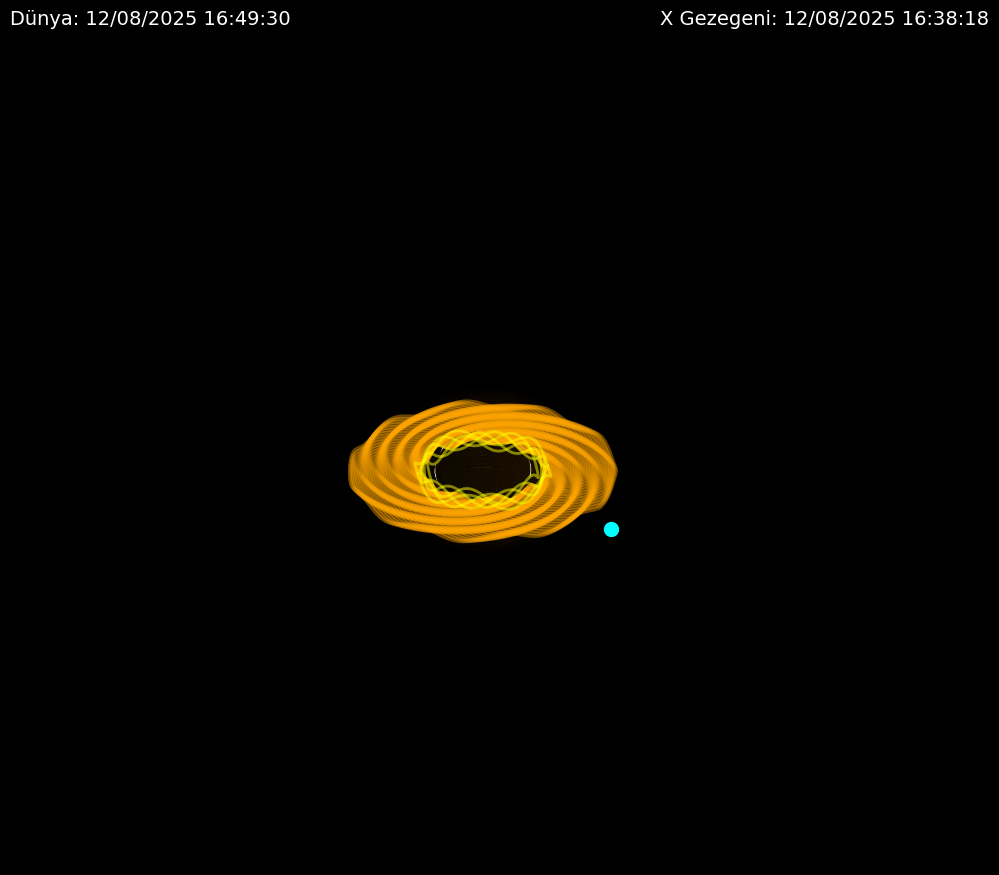

In [16]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
import datetime

# Kara delik parametreleri
r_s = 1.0              # Schwarzschild yarıçapı
r_s_vis = 1.15         # Görsel kara delik yarıçapı (biraz büyütüldü)
orbit_radius = 4.0     # Gezegen yörüngesi
time_step_sec = 10     # Her frame'de geçen gerçek zaman (saniye)

def time_dilation(r):
    if r <= r_s:
        return 0
    return np.sqrt(1 - r_s / r)

earth_start = datetime.datetime(2025, 8, 12, 15, 26, 0)
earth_time = 0.0
planet_time = 0.0

fig = plt.figure(figsize=(10,10))
ax = fig.add_subplot(111, projection='3d')
ax.set_xlim([-6,6])
ax.set_ylim([-6,6])
ax.set_zlim([-6,6])
ax.axis('off')
fig.patch.set_facecolor('black')
ax.set_facecolor('black')

# Küre koordinatları
u = np.linspace(0, 2*np.pi, 60)
v = np.linspace(0, np.pi, 30)
x_sphere = r_s_vis * np.outer(np.cos(u), np.sin(v))
y_sphere = r_s_vis * np.outer(np.sin(u), np.sin(v))
z_sphere = r_s_vis * np.outer(np.ones_like(u), np.cos(v))

# 1) İç kısım: opak siyah, kenarsız küre
ax.plot_surface(
    x_sphere, y_sphere, z_sphere,
    color='black', edgecolor=None, alpha=1, zorder=30)

# 2) Üzerine beyaz wireframe (tel kafes) - çizgiler biraz kalın ve seyrek
ax.plot_wireframe(
    x_sphere, y_sphere, z_sphere,
    color='white', linewidth=1.2, rstride=5, cstride=5, zorder=35)

# Accretion Disk (madde halkası)
theta = np.linspace(0, 2*np.pi, 300)
r_inner = r_s_vis * 1.3
r_outer = r_s_vis * 2.8
r_disk = np.linspace(r_inner, r_outer, 50)
z_wave_amp = 0.15

for r in r_disk:
    intensity = 0.6 + 0.4 * np.exp(-(r - r_inner)*5) + 0.2 * np.sin(20*theta + r*10)
    intensity = np.clip(intensity, 0, 1)
    
    x_disk = r * np.cos(theta)
    y_disk = r * np.sin(theta)
    z_disk = z_wave_amp * np.sin(10*theta + r*15)
    
    ax.plot(x_disk, y_disk, z_disk, color='orange', alpha=intensity.mean()*0.7, linewidth=3, zorder=25)

# Diskin iç kısmına doğru ışık bükülme için küçük halkalar
inner_rings = np.linspace(r_inner*0.9, r_inner*1.1, 5)
for radius in inner_rings:
    angle_ring = np.linspace(0, 2*np.pi, 200)
    x_ring = radius * np.cos(angle_ring)
    y_ring = radius * np.sin(angle_ring)
    z_ring = 0.3 * np.sin(5 * angle_ring + radius*20)
    ax.plot(x_ring, y_ring, z_ring, color='yellow', alpha=0.5, linewidth=2, zorder=28)

# 3D ışık bükülmesi efekti: olay ufku etrafında çok hafif küresel şeffaf halkalar
shell_radii = np.linspace(r_s_vis*1.7, r_s_vis*2.1, 4)
for radius in shell_radii:
    u_shell = np.linspace(0, 2*np.pi, 100)
    v_shell = np.linspace(0, np.pi, 50)
    U_shell, V_shell = np.meshgrid(u_shell, v_shell)
    wave = 0.03 * np.sin(15 * U_shell) * np.sin(10 * V_shell + radius*10)

    x_shell = (radius + wave) * np.cos(U_shell) * np.sin(V_shell)
    y_shell = (radius + wave) * np.sin(U_shell) * np.sin(V_shell)
    z_shell = (radius + wave) * np.cos(V_shell)

    ax.plot_surface(
        x_shell, y_shell, z_shell,
        color='orange', alpha=0.02, linewidth=0, zorder=15, shade=True)

# Gezegen
planet_dot, = ax.plot([], [], [], 'o', color='cyan', markersize=10, zorder=50)

earth_text = fig.text(0.05, 0.95, '', color='white', fontsize=14, backgroundcolor='black')
planet_text = fig.text(0.7, 0.95, '', color='white', fontsize=14, backgroundcolor='black')

def update(frame):
    global earth_time, planet_time

    earth_time += time_step_sec
    dilation = time_dilation(orbit_radius)
    planet_time += time_step_sec * dilation

    angle = frame * 0.05
    x = orbit_radius * np.cos(angle)
    y = orbit_radius * np.sin(angle)
    z = 0.3 * np.sin(3 * angle)
    planet_dot.set_data([x], [y])
    planet_dot.set_3d_properties([z])

    earth_datetime = earth_start + datetime.timedelta(seconds=earth_time)
    planet_datetime = earth_start + datetime.timedelta(seconds=planet_time)

    earth_text.set_text(f"Dünya: {earth_datetime.strftime('%d/%m/%Y %H:%M:%S')}")
    planet_text.set_text(f"X Gezegeni: {planet_datetime.strftime('%d/%m/%Y %H:%M:%S')}")

    return planet_dot, earth_text, planet_text

anim = FuncAnimation(fig, update, frames=500, interval=30, blit=False)

from IPython.display import HTML
HTML(anim.to_jshtml())
